# **1. Perkenalan Dataset**


Tahap pertama, Anda harus mencari dan menggunakan dataset **tanpa label** dengan ketentuan sebagai berikut:

1. **Sumber Dataset**:  
   Dataset dapat diperoleh dari berbagai sumber, seperti public repositories (*Kaggle*, *UCI ML Repository*, *Open Data*) atau data primer yang Anda kumpulkan sendiri.
   
2. **Ketentuan Dataset**:
   - **Tanpa label**: Dataset tidak boleh memiliki label atau kelas.
   - **Jumlah Baris**: Minimal 1000 baris untuk memastikan dataset cukup besar untuk analisis yang bermakna.
   - **Tipe Data**: Harus mengandung data **kategorikal** dan **numerikal**.
     - *Kategorikal*: Misalnya jenis kelamin, kategori produk.
     - *Numerikal*: Misalnya usia, pendapatan, harga.

3. **Pembatasan**:  
   Dataset yang sudah digunakan dalam latihan clustering (seperti customer segmentation) tidak boleh digunakan.

# **2. Import Library**

Pada tahap ini, Anda perlu mengimpor beberapa pustaka (library) Python yang dibutuhkan untuk analisis data dan pembangunan model machine learning.

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler, MinMaxScaler, LabelEncoder

# **3. Memuat Dataset**

Pada tahap ini, Anda perlu memuat dataset ke dalam notebook. Jika dataset dalam format CSV, Anda bisa menggunakan pustaka pandas untuk membacanya. Pastikan untuk mengecek beberapa baris awal dataset untuk memahami strukturnya dan memastikan data telah dimuat dengan benar.

Jika dataset berada di Google Drive, pastikan Anda menghubungkan Google Drive ke Colab terlebih dahulu. Setelah dataset berhasil dimuat, langkah berikutnya adalah memeriksa kesesuaian data dan siap untuk dianalisis lebih lanjut.

In [3]:
data = pd.read_csv('spotify_dataset.csv')
data


# Menampilkan ringkasan informasi dari dataset
data.info()

# Menampilkan statistik deskriptif dari dataset
data.describe(include="all")

# Memeriksa jumlah nilai yang hilang di setiap kolom
missing_values = data.isnull().sum()
missing_values[missing_values > 0]

less = missing_values[missing_values < 1000].index
over = missing_values[missing_values >= 1000].index

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20594 entries, 0 to 20593
Data columns (total 24 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Artist            20594 non-null  object 
 1   Track             20594 non-null  object 
 2   Album             20594 non-null  object 
 3   Album_type        20594 non-null  object 
 4   Danceability      20594 non-null  float64
 5   Energy            20594 non-null  float64
 6   Loudness          20594 non-null  float64
 7   Speechiness       20594 non-null  float64
 8   Acousticness      20594 non-null  float64
 9   Instrumentalness  20594 non-null  float64
 10  Liveness          20594 non-null  float64
 11  Valence           20594 non-null  float64
 12  Tempo             20594 non-null  float64
 13  Duration_min      20594 non-null  float64
 14  Title             20594 non-null  object 
 15  Channel           20594 non-null  object 
 16  Views             20594 non-null  float6

# **4. Exploratory Data Analysis (EDA)**

Pada tahap ini, Anda akan melakukan **Exploratory Data Analysis (EDA)** untuk memahami karakteristik dataset. EDA bertujuan untuk:

1. **Memahami Struktur Data**
   - Tinjau jumlah baris dan kolom dalam dataset.  
   - Tinjau jenis data di setiap kolom (numerikal atau kategorikal).

2. **Menangani Data yang Hilang**  
   - Identifikasi dan analisis data yang hilang (*missing values*). Tentukan langkah-langkah yang diperlukan untuk menangani data yang hilang, seperti pengisian atau penghapusan data tersebut.

3. **Analisis Distribusi dan Korelasi**  
   - Analisis distribusi variabel numerik dengan statistik deskriptif dan visualisasi seperti histogram atau boxplot.  
   - Periksa hubungan antara variabel menggunakan matriks korelasi atau scatter plot.

4. **Visualisasi Data**  
   - Buat visualisasi dasar seperti grafik distribusi dan diagram batang untuk variabel kategorikal.  
   - Gunakan heatmap atau pairplot untuk menganalisis korelasi antar variabel.

Tujuan dari EDA adalah untuk memperoleh wawasan awal yang mendalam mengenai data dan menentukan langkah selanjutnya dalam analisis atau pemodelan.


--- Struktur Data ---
Jumlah baris dan kolom: (20594, 28)
Tipe data setiap kolom:
Artist                int64
Track                 int64
Album                 int64
Album_type            int64
Danceability        float64
Energy              float64
Loudness            float64
Speechiness         float64
Acousticness        float64
Instrumentalness    float64
Liveness            float64
Valence             float64
Tempo               float64
Duration_min        float64
Title                 int64
Channel               int64
Views               float64
Likes               float64
Comments            float64
Licensed              int64
official_video        int64
Stream              float64
EnergyLiveness      float64
most_playedon         int64
Cluster               int32
PCA1                float64
PCA2                float64
DBSCAN_Cluster        int64
dtype: object

--- Lima Baris Pertama ---
   Artist  Track  Album  Album_type  Danceability    Energy  Loudness  \
0     686   4982  

<ipython-input-20-e135fae3f163>:15: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.fillna(method='ffill')  # Contoh: Mengisi dengan nilai sebelumnya


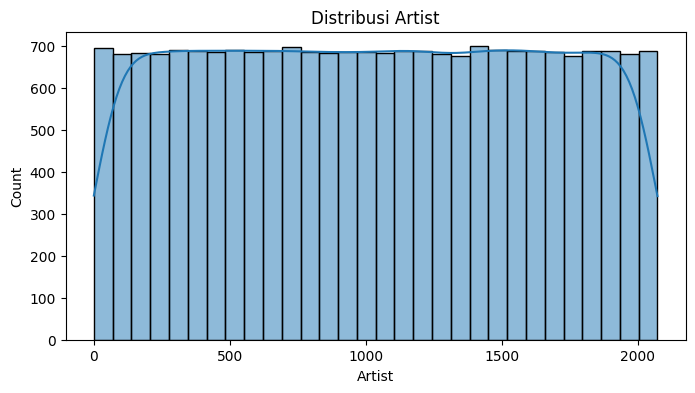

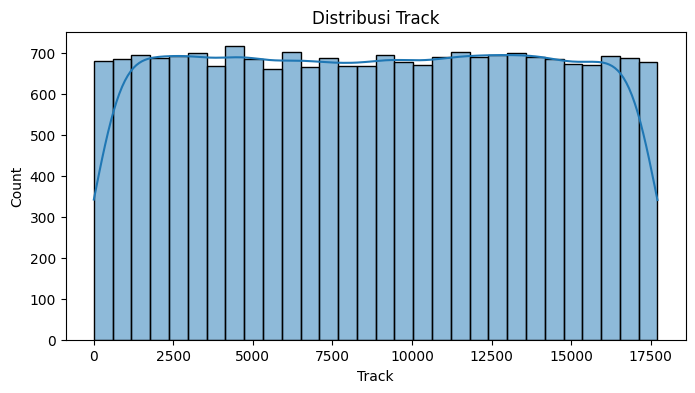

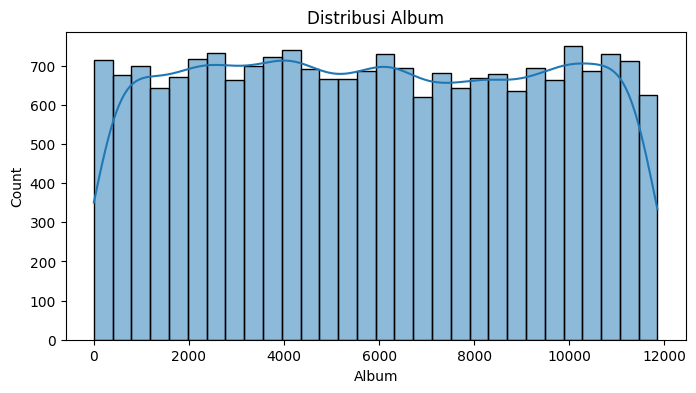

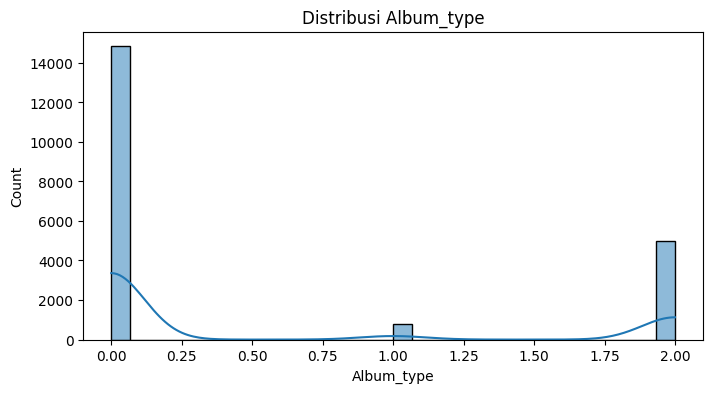

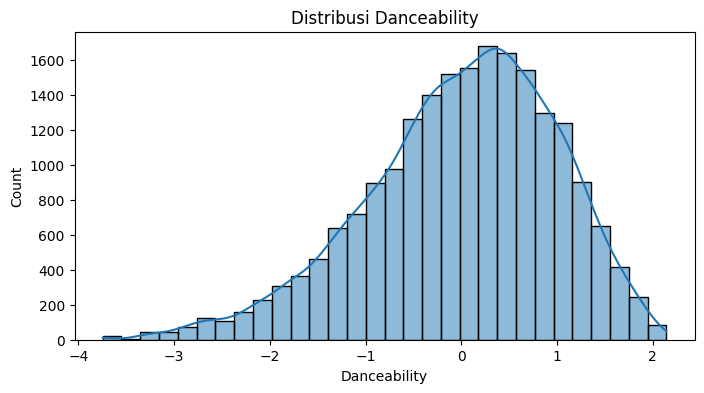

...

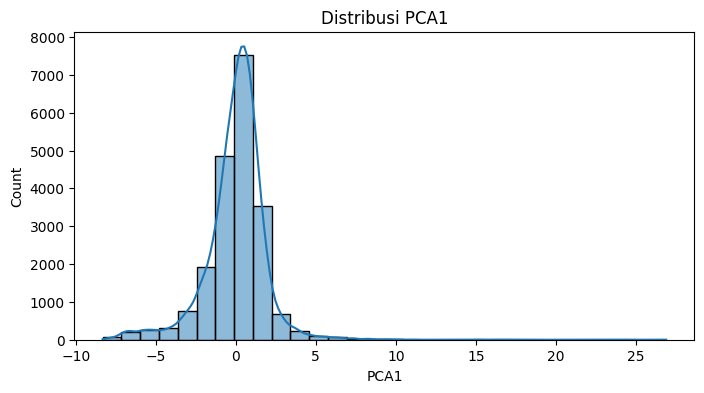

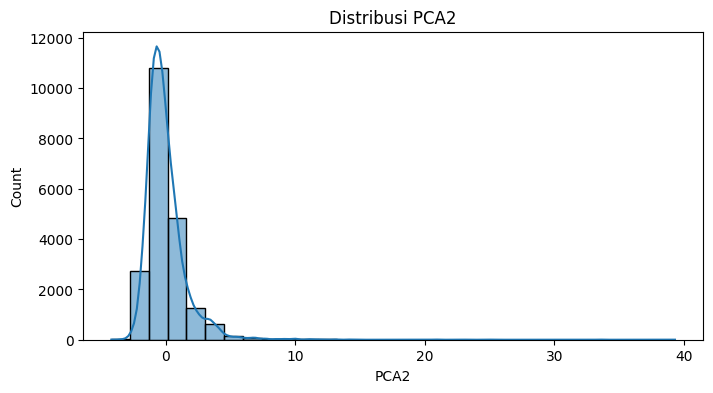

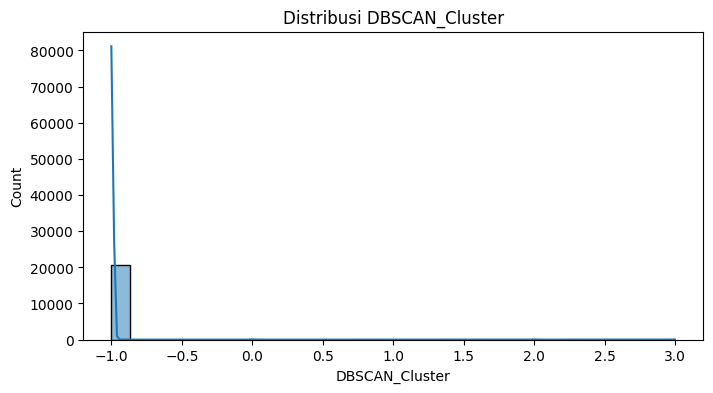

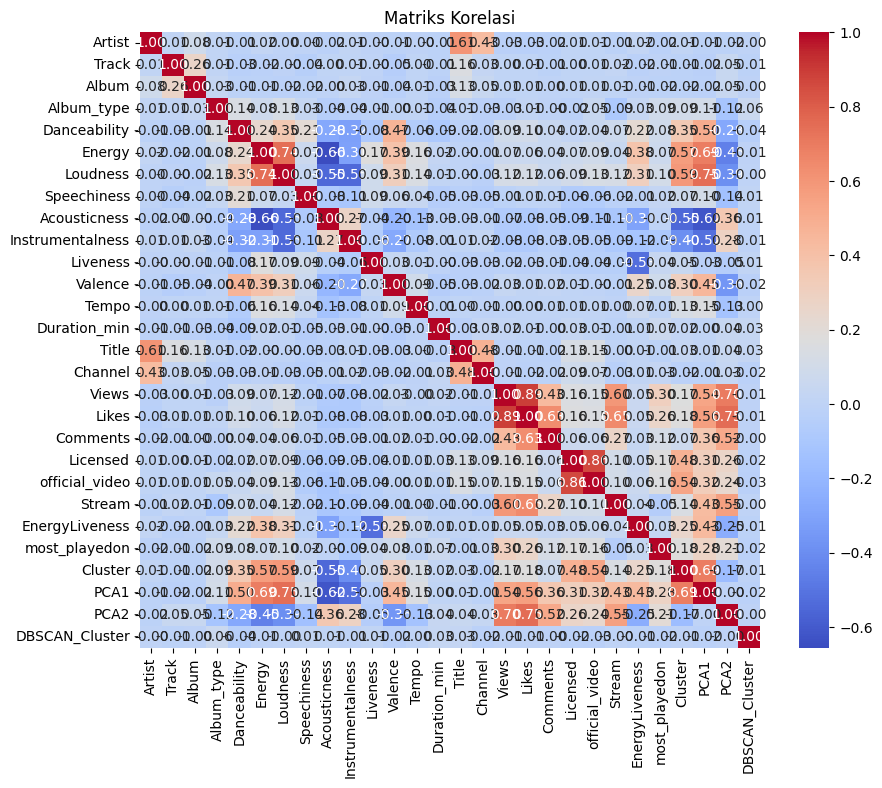

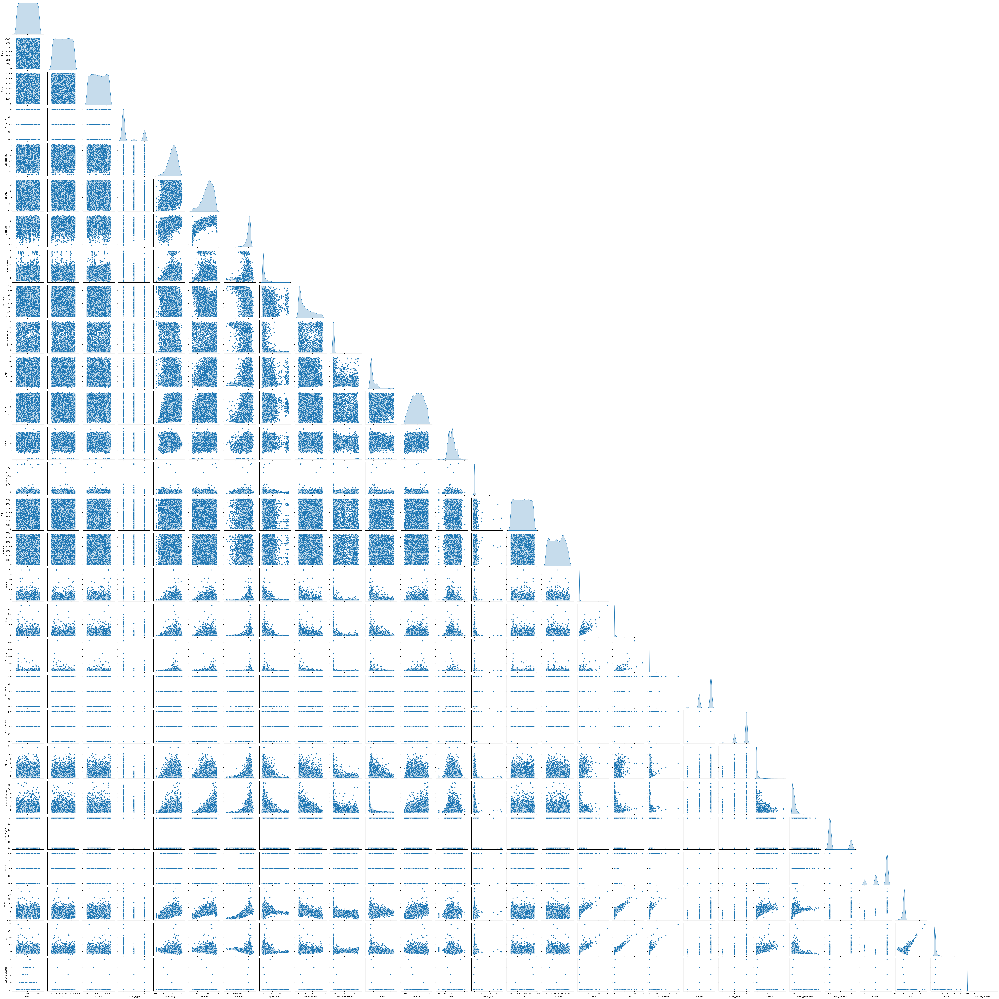

In [20]:
# 1. Memahami Struktur Data
print("\n--- Struktur Data ---")
print(f"Jumlah baris dan kolom: {data.shape}")
print(f"Tipe data setiap kolom:\n{data.dtypes}")
print("\n--- Lima Baris Pertama ---")
print(data.head())

# 2. Menangani Data yang Hilang
print("\n--- Data yang Hilang ---")
missing_values = data.isnull().sum()
missing_percentage = (missing_values / len(data)) * 100
print(pd.DataFrame({'Jumlah Data Hilang': missing_values, 'Persentase': missing_percentage}))

# Opsional: Mengisi data hilang dengan nilai tertentu atau menghapus baris yang hilang
data = data.fillna(method='ffill')  # Contoh: Mengisi dengan nilai sebelumnya
# data = data.dropna()             # Contoh: Menghapus baris dengan nilai hilang

# 3. Analisis Distribusi dan Korelasi
print("\n--- Statistik Deskriptif ---")
print(data.describe())

# Pisahkan kolom numerik dan kategorikal
numerical_columns = data.select_dtypes(include=[np.number]).columns
categorical_columns = data.select_dtypes(include=['object']).columns

# Visualisasi distribusi variabel numerik
for col in numerical_columns:
    plt.figure(figsize=(8, 4))
    sns.histplot(data[col], kde=True, bins=30)
    plt.title(f"Distribusi {col}")
    plt.show()

# Visualisasi korelasi
if not numerical_columns.empty:
    correlation_matrix = data[numerical_columns].corr()
    plt.figure(figsize=(10, 8))
    sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt='.2f')
    plt.title('Matriks Korelasi')
    plt.show()

# Scatter plot untuk beberapa variabel (contoh: Income dengan fitur numerik utama)
if 'Income' in data.columns:
    for col in numerical_columns:
        if col != 'Income':
            plt.figure(figsize=(8, 4))
            sns.scatterplot(x=data[col], y=data['Income'])
            plt.title(rf"Hubungan antara {col} dan Income")
            plt.xlabel(rf"{col}")
            plt.ylabel(r"Income")
            plt.show()

# 4. Visualisasi Data
# Visualisasi variabel kategorikal
for col in categorical_columns:
    plt.figure(figsize=(8, 4))
    ax = sns.countplot(data[col], order=data[col].value_counts().index)
    plt.title(rf"Distribusi {col}")
    plt.xticks(rotation=45)

    # Menangani simbol khusus dalam label sumbu x menggunakan re.escape
    import re
    ax.set_xticklabels([re.escape(label.get_text().replace('\n', ' ')) for label in ax.get_xticklabels()])
    plt.show()

# Pairplot untuk hubungan antar variabel numerik (hanya jika ada lebih dari satu kolom numerik)
if len(numerical_columns) > 1:
    sns.pairplot(data[numerical_columns], diag_kind='kde', corner=True)
    plt.show()


# **5. Data Preprocessing**

Pada tahap ini, data preprocessing adalah langkah penting untuk memastikan kualitas data sebelum digunakan dalam model machine learning. Data mentah sering kali mengandung nilai kosong, duplikasi, atau rentang nilai yang tidak konsisten, yang dapat memengaruhi kinerja model. Oleh karena itu, proses ini bertujuan untuk membersihkan dan mempersiapkan data agar analisis berjalan optimal.

Berikut adalah tahapan-tahapan yang bisa dilakukan, tetapi **tidak terbatas** pada:
1. Menghapus atau Menangani Data Kosong (Missing Values)
2. Menghapus Data Duplikat
3. Normalisasi atau Standarisasi Fitur
4. Deteksi dan Penanganan Outlier
5. Encoding Data Kategorikal
6. Binning (Pengelompokan Data)

Cukup sesuaikan dengan karakteristik data yang kamu gunakan yah.


--- Data Kosong Sebelum Penanganan ---
Series([], dtype: int64)

--- Data Kosong Setelah Penanganan ---
Artist              0
Track               0
Album               0
Album_type          0
Danceability        0
Energy              0
Loudness            0
Speechiness         0
Acousticness        0
Instrumentalness    0
Liveness            0
Valence             0
Tempo               0
Duration_min        0
Title               0
Channel             0
Views               0
Likes               0
Comments            0
Licensed            0
official_video      0
Stream              0
EnergyLiveness      0
most_playedon       0
Cluster             0
PCA1                0
PCA2                0
DBSCAN_Cluster      0
dtype: int64

--- Jumlah Data Duplikat Sebelum ---
0

--- Jumlah Data Duplikat Setelah ---
0

--- Data Setelah Standarisasi ---
     Artist     Track     Album  Album_type  Danceability    Energy  Loudness  \
0 -0.584966 -0.756061 -0.954137   -0.608940      1.195758  0.325870  0

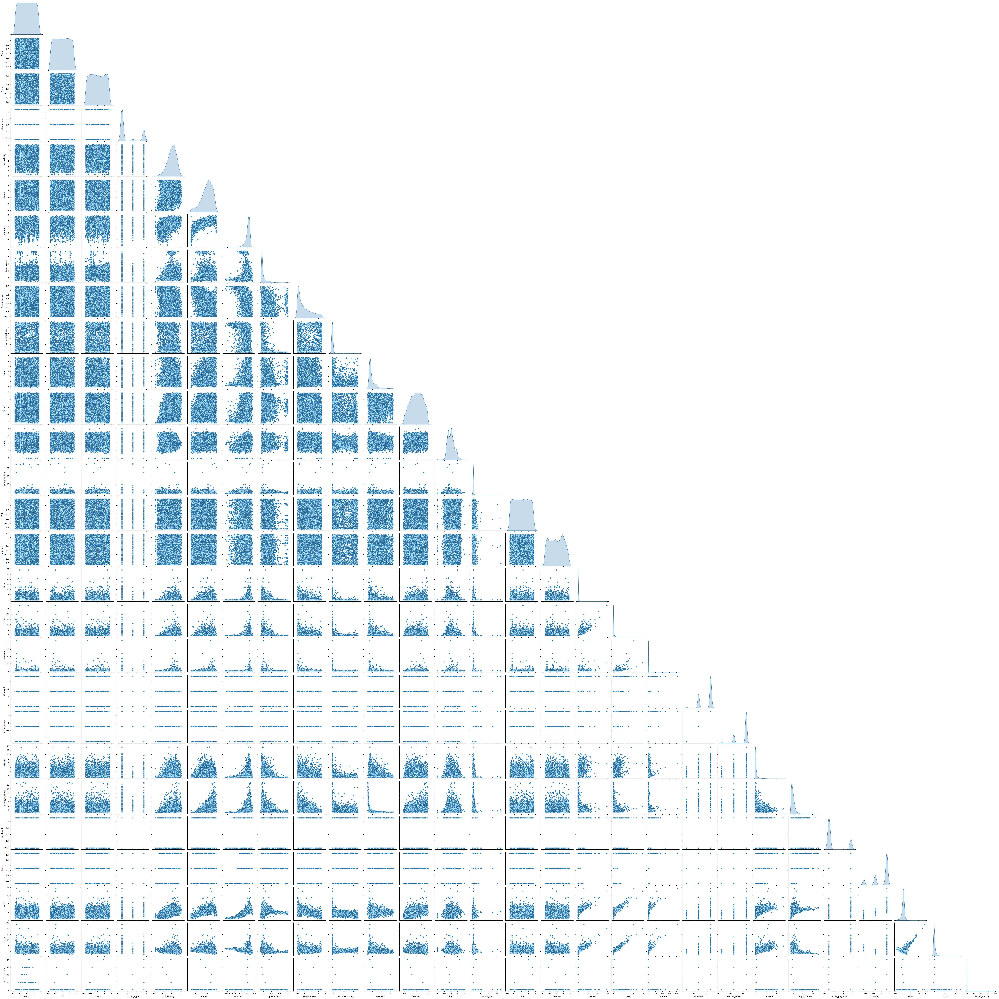

In [22]:
# 1. Menangani Data Kosong (Missing Values)
print("\n--- Data Kosong Sebelum Penanganan ---")
missing_values = data.isnull().sum()
print(missing_values[missing_values > 0])

# Mengisi data kosong dengan median untuk kolom numerik
numerical_cols = data.select_dtypes(include=np.number).columns
data[numerical_cols] = data[numerical_cols].fillna(data[numerical_cols].median())

# Mengisi data kosong dengan modus untuk kolom kategorikal
categorical_cols = data.select_dtypes(include='object').columns
# Check if there are any categorical columns before filling missing values
if len(categorical_cols) > 0:
    data[categorical_cols] = data[categorical_cols].fillna(data[categorical_cols].mode().iloc[0])

print("\n--- Data Kosong Setelah Penanganan ---")
print(data.isnull().sum())

# 2. Menghapus Data Duplikat
print("\n--- Jumlah Data Duplikat Sebelum ---")
print(data.duplicated().sum())
data = data.drop_duplicates()
print("\n--- Jumlah Data Duplikat Setelah ---")
print(data.duplicated().sum())

# 3. Normalisasi atau Standarisasi Fitur
#Standarisasi menggunakan StandardScaler
scaler = StandardScaler()
data[numerical_cols] = scaler.fit_transform(data[numerical_cols])

# Alternatif: Normalisasi menggunakan MinMaxScaler
# scaler = MinMaxScaler()
# data[numerical_cols] = scaler.fit_transform(data[numerical_cols])

print("\n--- Data Setelah Standarisasi ---")
print(data[numerical_cols].head())

# 4. Deteksi dan Penanganan Outlier
# Menggunakan IQR untuk mendeteksi outlier
for col in numerical_cols:
    Q1 = data[col].quantile(0.25)
    Q3 = data[col].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    outliers = (data[col] < lower_bound) | (data[col] > upper_bound)
    print(f"\nOutlier pada {col}: {outliers.sum()} ditemukan.")
    # Opsional: Tangani outlier (drop atau impute)
    # data = data[~outliers]

# 5. Encoding Data Kategorikal
encoder = LabelEncoder()
for col in categorical_cols:
    data[col] = encoder.fit_transform(data[col])
print("\n--- Data Setelah Encoding ---")
print(data[categorical_cols].head())

# 6. Binning (Pengelompokan Data)
# Contoh: Binning untuk kolom numerik (misal: Age)
if 'Age' in data.columns:
    data['Age_Group'] = pd.cut(data['Age'], bins=[0, 18, 35, 60, 100], labels=['Child', 'Youth', 'Adult', 'Senior'])
    print("\n--- Distribusi Age_Group ---")
    print(data['Age_Group'].value_counts())

# Visualisasi Data Setelah Preprocessing
sns.pairplot(data[numerical_cols], diag_kind='kde', corner=True)
plt.show()

# **6. Pembangunan Model Clustering**

## **a. Pembangunan Model Clustering**

Pada tahap ini, Anda membangun model clustering dengan memilih algoritma yang sesuai untuk mengelompokkan data berdasarkan kesamaan. Berikut adalah **rekomendasi** tahapannya.
1. Pilih algoritma clustering yang sesuai.
2. Latih model dengan data menggunakan algoritma tersebut.

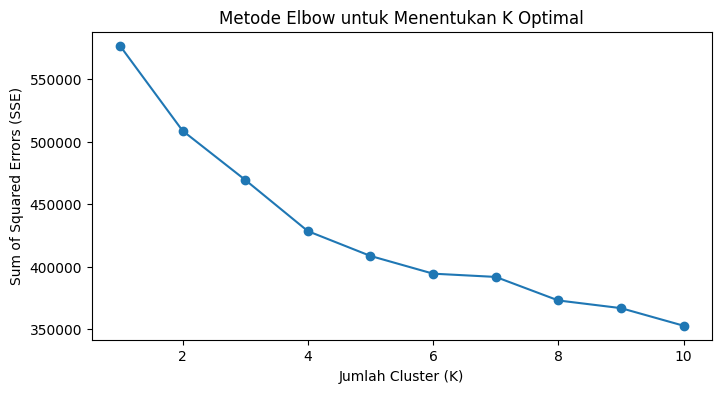

Silhouette Score untuk K=3: 0.14


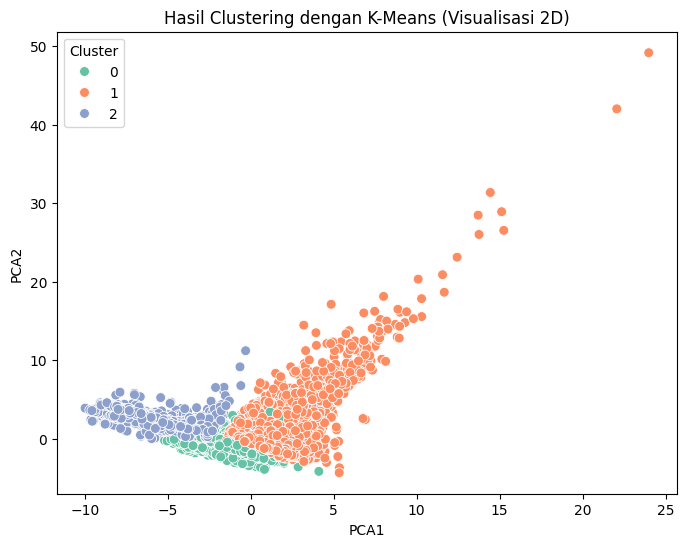

Jumlah cluster DBSCAN: 4


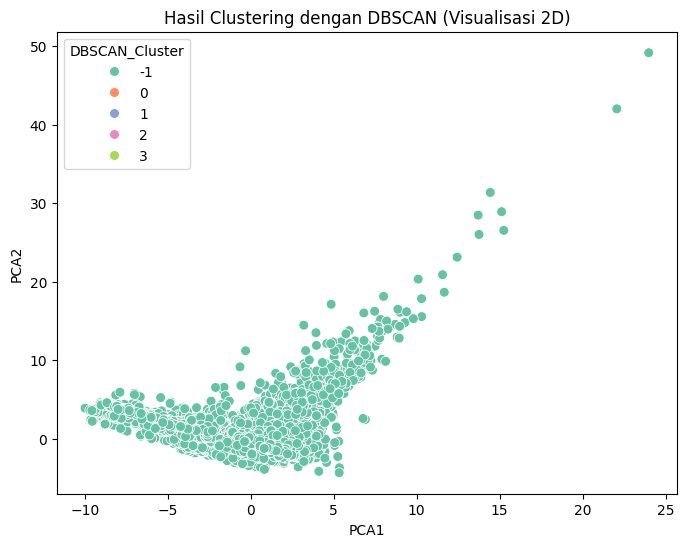

In [23]:
import pandas as pd
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt
import seaborn as sns

# Data preprocessing: normalisasi fitur numerik
numerical_cols = data.select_dtypes(include='number').columns
scaler = StandardScaler()
data_scaled = scaler.fit_transform(data[numerical_cols])

# 1. Menentukan jumlah cluster (K) dengan Metode Elbow
sse = []
range_clusters = range(1, 11)  # Evaluasi untuk K dari 1 hingga 10

for k in range_clusters:
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(data_scaled)
    sse.append(kmeans.inertia_)

# Visualisasi SSE untuk menentukan K optimal
plt.figure(figsize=(8, 4))
plt.plot(range_clusters, sse, marker='o')
plt.title('Metode Elbow untuk Menentukan K Optimal')
plt.xlabel('Jumlah Cluster (K)')
plt.ylabel('Sum of Squared Errors (SSE)')
plt.show()

# 2. Melatih model dengan jumlah cluster yang dipilih (K=3)
optimal_k = 3  # Ubah sesuai hasil Elbow
kmeans = KMeans(n_clusters=optimal_k, random_state=42)
kmeans.fit(data_scaled)

# 3. Menambahkan label cluster ke dataset
data['Cluster'] = kmeans.labels_

# 4. Evaluasi clustering dengan Silhouette Score
silhouette_avg = silhouette_score(data_scaled, kmeans.labels_)
print(f"Silhouette Score untuk K={optimal_k}: {silhouette_avg:.2f}")

# 5. Visualisasi hasil clustering (PCA untuk dimensi 2D)
from sklearn.decomposition import PCA

pca = PCA(n_components=2)
data_pca = pca.fit_transform(data_scaled)
data['PCA1'] = data_pca[:, 0]
data['PCA2'] = data_pca[:, 1]

plt.figure(figsize=(8, 6))
sns.scatterplot(
    x='PCA1', y='PCA2', hue='Cluster', palette='Set2', data=data, s=50
)
plt.title('Hasil Clustering dengan K-Means (Visualisasi 2D)')
plt.show()

# Algoritma Clustering Lain
# DBSCAN
from sklearn.cluster import DBSCAN

dbscan = DBSCAN(eps=0.5, min_samples=5)
dbscan_labels = dbscan.fit_predict(data_scaled)

data['DBSCAN_Cluster'] = dbscan_labels
print(f"Jumlah cluster DBSCAN: {len(set(dbscan_labels)) - (1 if -1 in dbscan_labels else 0)}")

# Visualisasi hasil clustering DBSCAN
plt.figure(figsize=(8, 6))
sns.scatterplot(
    x='PCA1', y='PCA2', hue='DBSCAN_Cluster', palette='Set2', data=data, s=50
)
plt.title('Hasil Clustering dengan DBSCAN (Visualisasi 2D)')
plt.show()


## **b. Evaluasi Model Clustering**

Untuk menentukan jumlah cluster yang optimal dalam model clustering, Anda dapat menggunakan metode Elbow atau Silhouette Score.

Metode ini membantu kita menemukan jumlah cluster yang memberikan pemisahan terbaik antar kelompok data, sehingga model yang dibangun dapat lebih efektif. Berikut adalah **rekomendasi** tahapannya.
1. Gunakan Silhouette Score dan Elbow Method untuk menentukan jumlah cluster optimal.
2. Hitung Silhouette Score sebagai ukuran kualitas cluster.

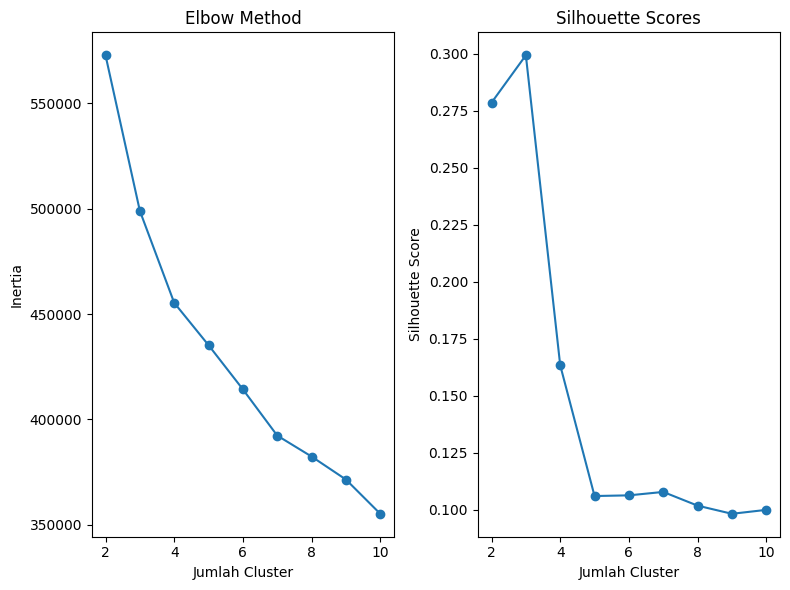

In [24]:
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
import numpy as np

# Tentukan rentang jumlah cluster yang akan diuji
range_n_clusters = range(2, 11)

# Menyimpan inertia dan silhouette scores
inertia = []
silhouette_scores = []

for n_clusters in range_n_clusters:
    kmeans = KMeans(n_clusters=n_clusters, random_state=42)
    kmeans.fit(data)

    # Menghitung inertia untuk Elbow Method
    inertia.append(kmeans.inertia_)

    # Menghitung Silhouette Score
    silhouette_scores.append(silhouette_score(data, kmeans.labels_))

# Plot Elbow Method (Inertia vs Jumlah Cluster)
plt.figure(figsize=(8, 6))
plt.subplot(1, 2, 1)
plt.plot(range_n_clusters, inertia, marker='o')
plt.title('Elbow Method')
plt.xlabel('Jumlah Cluster')
plt.ylabel('Inertia')

# Plot Silhouette Scores
plt.subplot(1, 2, 2)
plt.plot(range_n_clusters, silhouette_scores, marker='o')
plt.title('Silhouette Scores')
plt.xlabel('Jumlah Cluster')
plt.ylabel('Silhouette Score')

plt.tight_layout()
plt.show()


## **c. Feature Selection (Opsional)**

---



Silakan lakukan feature selection jika Anda membutuhkan optimasi model clustering. Jika Anda menerapkan proses ini, silakan lakukan pemodelan dan evaluasi kembali menggunakan kolom-kolom hasil feature selection. Terakhir, bandingkan hasil performa model sebelum dan sesudah menerapkan feature selection.

In [25]:
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
import pandas as pd

# Langkah pertama adalah standarisasi data
scaler = StandardScaler()
data_scaled = scaler.fit_transform(data)

# A. Menggunakan PCA untuk dimensionality reduction
pca = PCA(n_components=5)  # Tentukan jumlah komponen utama yang ingin dipertahankan
data_pca = pca.fit_transform(data_scaled)

# B. Menggunakan RandomForest untuk feature importance
# --- Assuming 'Cluster' column is the target ---
labels = data['Cluster']  # Define 'labels' using the 'Cluster' column
rf = RandomForestClassifier(n_estimators=100, random_state=42)
rf.fit(data_scaled, labels)  # 'labels' adalah target label yang mungkin ada dalam dataset
feature_importances = rf.feature_importances_

# Menampilkan pentingnya fitur
feature_importance_df = pd.DataFrame({
    'Feature': data.columns,
    'Importance': feature_importances
}).sort_values(by='Importance', ascending=False)

print(feature_importance_df)

             Feature  Importance
24           Cluster    0.343361
25              PCA1    0.161283
20    official_video    0.154731
19          Licensed    0.108902
5             Energy    0.052391
26              PCA2    0.051616
8       Acousticness    0.033625
6           Loudness    0.025192
17             Likes    0.016032
18          Comments    0.010066
16             Views    0.010005
9   Instrumentalness    0.006401
11           Valence    0.005287
4       Danceability    0.005144
22    EnergyLiveness    0.003554
15           Channel    0.003445
7        Speechiness    0.001664
14             Title    0.001442
21            Stream    0.001299
13      Duration_min    0.000804
3         Album_type    0.000665
12             Tempo    0.000578
0             Artist    0.000558
10          Liveness    0.000486
23     most_playedon    0.000452
1              Track    0.000444
2              Album    0.000369
27    DBSCAN_Cluster    0.000205


### Permodelan clustering sebelum dan sesudah feature enginering

In [26]:
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score

# Pemodelan Clustering sebelum Feature Selection
kmeans_original = KMeans(n_clusters=3, random_state=42)
kmeans_original.fit(data_scaled)
silhouette_original = silhouette_score(data_scaled, kmeans_original.labels_)

# Pemodelan Clustering setelah Feature Selection (misalnya menggunakan PCA)
kmeans_pca = KMeans(n_clusters=3, random_state=42)
kmeans_pca.fit(data_pca)
silhouette_pca = silhouette_score(data_pca, kmeans_pca.labels_)

print(f'Silhouette Score (Sebelum Feature Selection): {silhouette_original}')
print(f'Silhouette Score (Setelah Feature Selection dengan PCA): {silhouette_pca}')


Silhouette Score (Sebelum Feature Selection): 0.24774053115651193
Silhouette Score (Setelah Feature Selection dengan PCA): 0.30491724042138274


## **d. Visualisasi Hasil Clustering**

Setelah model clustering dilatih dan jumlah cluster optimal ditentukan, langkah selanjutnya adalah menampilkan hasil clustering melalui visualisasi.

Berikut adalah **rekomendasi** tahapannya.
1. Tampilkan hasil clustering dalam bentuk visualisasi, seperti grafik scatter plot atau 2D PCA projection.

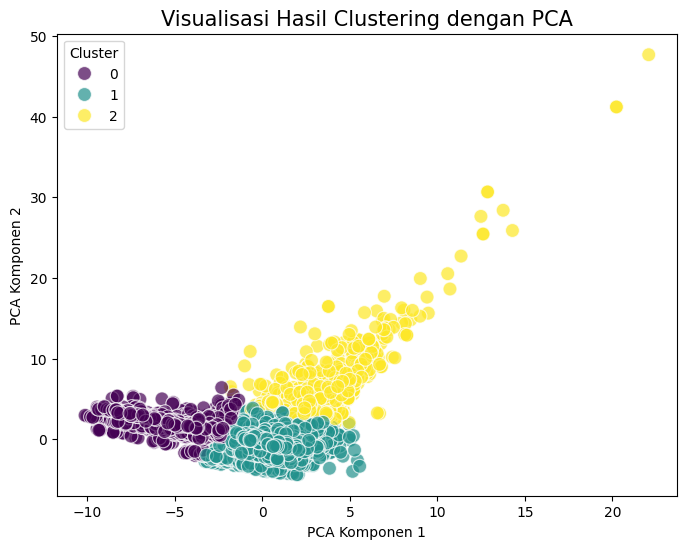

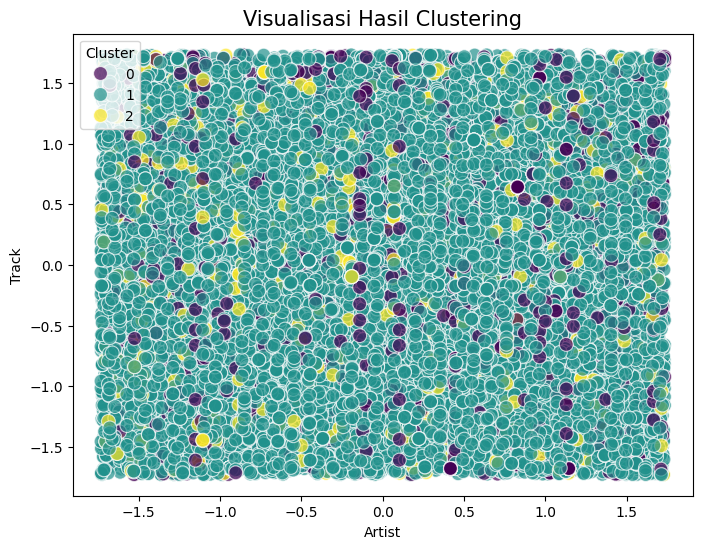

In [27]:
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
import seaborn as sns

# 1. Lakukan PCA untuk mengurangi dimensi menjadi 2D
pca = PCA(n_components=2)
data_pca = pca.fit_transform(data_scaled)

# 2. Latih model KMeans dengan jumlah cluster optimal (misalnya 3)
kmeans = KMeans(n_clusters=3, random_state=42)
kmeans.fit(data_scaled)

# 3. Dapatkan label cluster
labels = kmeans.labels_

# 4. Visualisasikan hasil clustering dalam 2D setelah PCA
plt.figure(figsize=(8, 6))
sns.scatterplot(x=data_pca[:, 0], y=data_pca[:, 1], hue=labels, palette='viridis', s=100, alpha=0.7)
plt.title('Visualisasi Hasil Clustering dengan PCA', fontsize=15)
plt.xlabel('PCA Komponen 1')
plt.ylabel('PCA Komponen 2')
plt.legend(title='Cluster', loc='best')
plt.show()

# Replace 'Feature1' and 'Feature2' with actual column names from your DataFrame
# For example, if your DataFrame has columns 'Popularity' and 'Danceability'
# You would change the code below to:
# sns.scatterplot(x=data['Popularity'], y=data['Danceability'], hue=labels, palette='viridis', s=100, alpha=0.7)

# Get the first two numerical features from your data
numerical_features = data.select_dtypes(include=['number']).columns[:2]

plt.figure(figsize=(8, 6))
sns.scatterplot(x=data[numerical_features[0]], y=data[numerical_features[1]], hue=labels, palette='viridis', s=100, alpha=0.7)
plt.title('Visualisasi Hasil Clustering', fontsize=15)
plt.xlabel(numerical_features[0])
plt.ylabel(numerical_features[1])
plt.legend(title='Cluster', loc='best')
plt.show()

## **e. Analisis dan Interpretasi Hasil Cluster**

Setelah melakukan clustering, langkah selanjutnya adalah menganalisis karakteristik dari masing-masing cluster berdasarkan fitur yang tersedia.

Berikut adalah **rekomendasi** tahapannya.
1. Analisis karakteristik tiap cluster berdasarkan fitur yang tersedia (misalnya, distribusi nilai dalam cluster).
2. Berikan interpretasi: Apakah hasil clustering sesuai dengan ekspektasi dan logika bisnis? Apakah ada pola tertentu yang bisa dimanfaatkan?

### 1.Statistik Deskriptif per Cluster

In [28]:
import pandas as pd

# Menambahkan label cluster ke dalam data
data['Cluster'] = labels  # 'labels' adalah hasil dari KMeans clustering

# Melihat statistik deskriptif per cluster
cluster_stats = data.groupby('Cluster').describe()
print(cluster_stats)


          Artist                                                              \
           count      mean       std       min       25%       50%       75%   
Cluster                                                                        
0         2390.0 -0.003859  0.994568 -1.721628 -0.825671 -0.101885  0.880575   
1        17407.0  0.007298  1.000170 -1.731657 -0.859102  0.018467  0.870964   
2          797.0 -0.147812  1.002887 -1.728314 -1.036288 -0.187135  0.702136   

                     Track            ...      PCA2            DBSCAN_Cluster  \
              max    count      mean  ...       75%        max          count   
Cluster                               ...                                       
0        1.733489   2390.0  0.063516  ...  2.464229   6.535265         2390.0   
1        1.731818  17407.0 -0.012207  ...  0.035529   4.200640        17407.0   
2        1.726803    797.0  0.076142  ...  6.991523  49.181646          797.0   

                                

### 2. Distribusi Nilai dalam Cluster

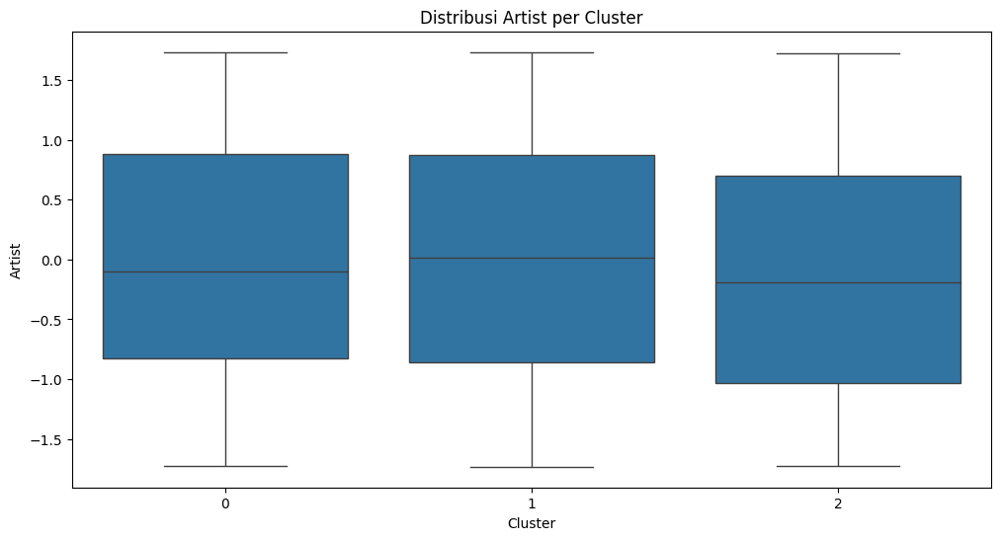

In [29]:
# Visualisasi distribusi nilai untuk fitur tertentu (misalnya, 'Feature1')
# Replace 'Feature1' with the name of an actual numerical column from your data
numerical_feature = data.select_dtypes(include=['number']).columns[0]  # Select the first numerical feature

plt.figure(figsize=(12, 6))
sns.boxplot(x='Cluster', y=numerical_feature, data=data)  # Replace 'Feature1' with numerical_feature
plt.title(f'Distribusi {numerical_feature} per Cluster')
plt.show()

### 3.Analisis Korelasi antara Fitur dan Cluster

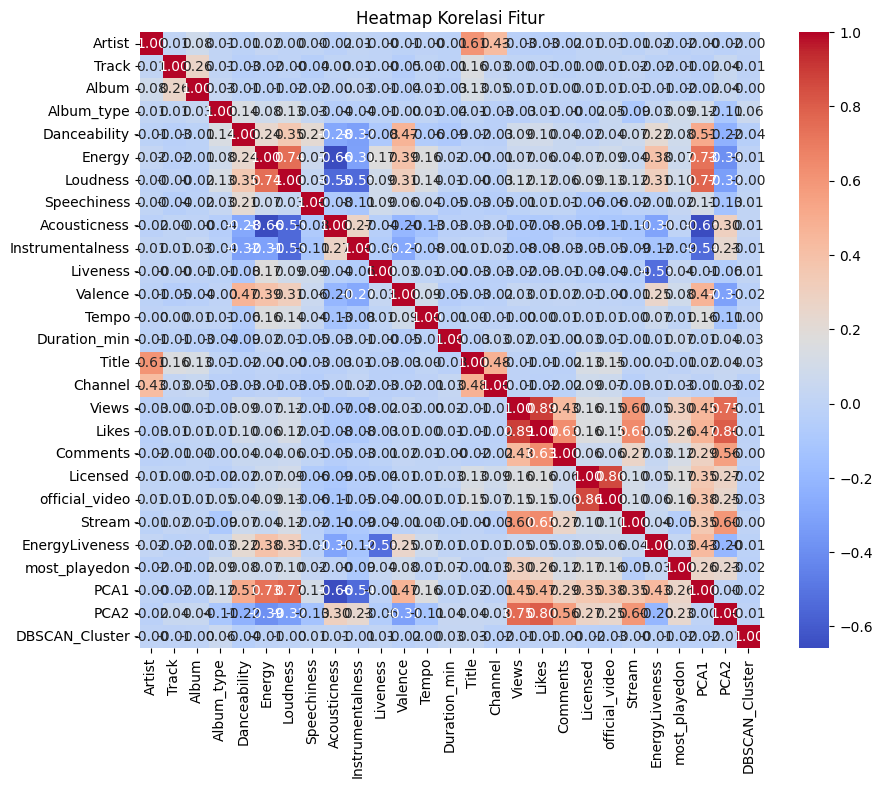

In [30]:
# Korelasi antara fitur dan cluster (menggunakan heatmap)
correlation = data.drop('Cluster', axis=1).corr()
plt.figure(figsize=(10, 8))
sns.heatmap(correlation, annot=True, cmap='coolwarm', fmt='.2f')
plt.title('Heatmap Korelasi Fitur')
plt.show()

Tulis hasil interpretasinya di sini.
1. Cluster 1:
2. Cluster 2:
3. Cluster 3:

# **7. Mengeksport Data**

Simpan hasilnya ke dalam file CSV.

In [19]:
from google.colab import files


# Menyimpan file CSV
cluster_stats.to_csv('cluster_stats.csv', index=True)
data.to_csv('data_with_clusters.csv', index=False)
correlation.to_csv('feature_correlation.csv', index=True)

# Mendownload file yang disimpan
files.download('cluster_stats.csv')
files.download('data_with_clusters.csv')
files.download('feature_correlation.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>